In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [2]:
#memasukkan data
df = pd.read_excel('SuddecCardiacDeathv3.xlsx', header=[0,1])
t = df[df.columns[0]]
s1 = df[df.columns[1]]
s2 = df[df.columns[2]]
fs = 1/0.004
N = len(df.index)

## Sinyal Domain Waktu

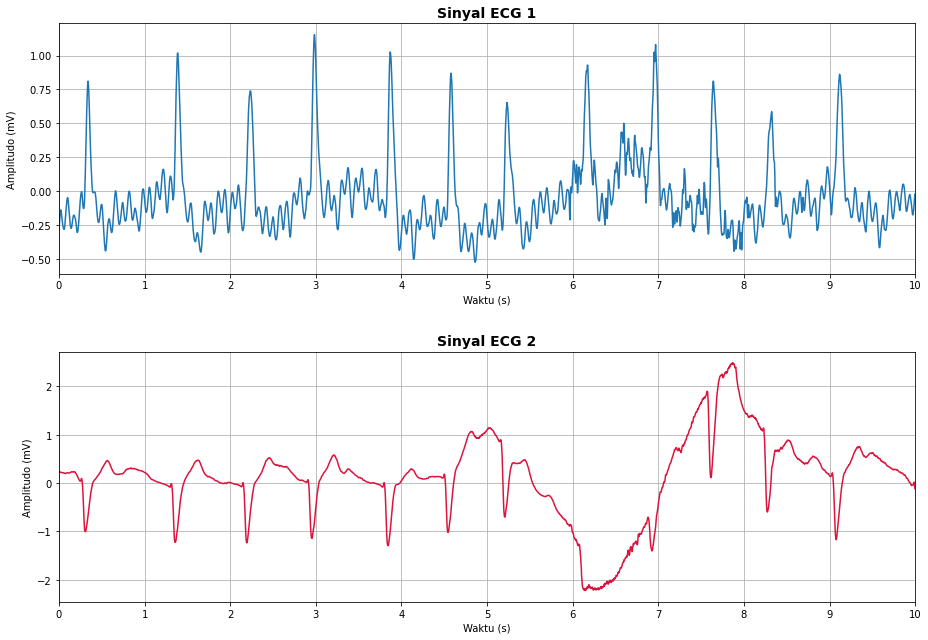

In [3]:
fig, axs = plt.subplots(2, figsize=(13,9))
axs[0].plot(t*0.004,s1)
axs[0].set_title('Sinyal ECG 1',fontweight="bold", size=14)
axs[1].plot(t*0.004,s2,'crimson')
axs[1].set_title('Sinyal ECG 2',fontweight="bold", size=14)
for ax in axs.flat:
    ax.set(xlabel='Waktu (s)',ylabel='Amplitudo (mV)', xlim=(0,10), xticks=(np.arange(0,11)))
    ax.grid()
fig.tight_layout(h_pad=3)

## Domain Frekuensi

In [4]:
def DFT(sinyal,clr,judul):
    re_X = np.zeros(100000)
    im_X = np.zeros(100000)
    magX = np.zeros(100000)
    
    #DFT
    for k in range(N):
        for n in range(N):
            re_X[k] += sinyal[n]*np.cos(2*np.pi*k*n/N)
            im_X[k] -= sinyal[n]*np.sin(2*np.pi*k*n/N)
        magX[k] = np.sqrt((re_X[k])**2 + (im_X[k])**2)

    # plot
    k = np.arange(0,np.ceil(N/2),1,dtype=int) 
    plt.figure(figsize=(15,5))
    plt.bar(k*fs/N,magX[k],width=0.4,color=clr)
    plt.title(judul, fontweight="bold",size=14)
    plt.xlabel('Frekuensi (Hz)',size=13)
    plt.ylabel('Magnitudo',size=13)
    plt.xlim(0, fs/2)
    plt.xticks(np.linspace(0,120,13,dtype=int))
    plt.grid()
    plt.show()

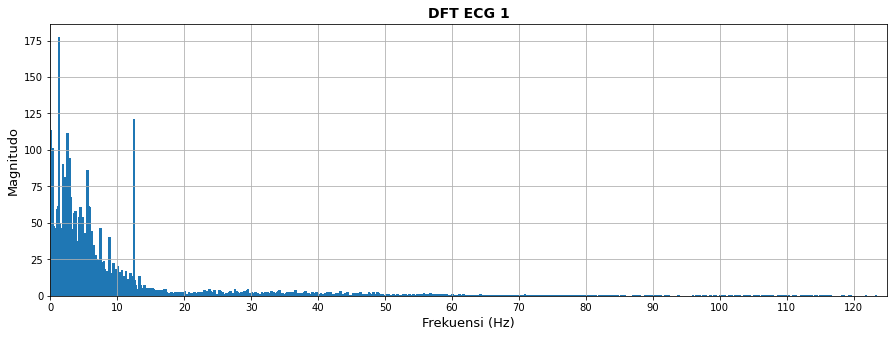

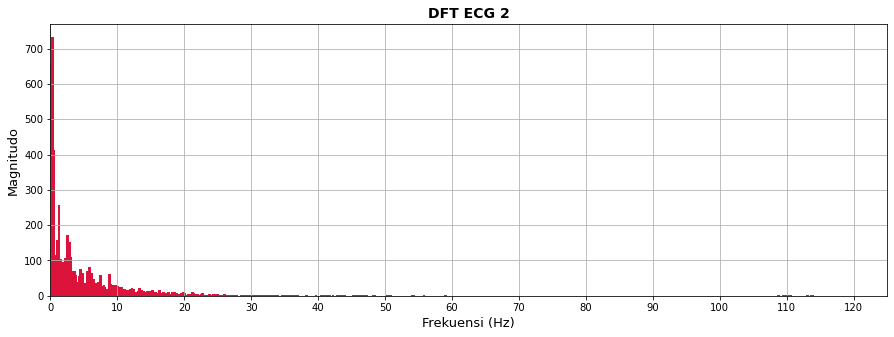

In [7]:
DFT(s1,'#1f77b4','DFT ECG 1')
DFT(s2,'crimson','DFT ECG 2')